# Proyecto individual

In [1]:
import pandas as pd
import numpy as np
import re
import json
import ast
#pip install missingno
import missingno as msno


## Dataset: Movies: 
#### 1.0 Lectura de archivos

In [2]:
df = pd.read_csv("../movies_dataset.csv")
print("dimensiones de la data:",df.shape)

dimensiones de la data: (45466, 24)


C:\Users\Pablo\AppData\Local\Temp\ipykernel_14884\2506349904.py:1: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("../movies_dataset.csv")


### 1.1 valores nulos de la data

In [3]:
df.isna().sum()

adult                        0
belongs_to_collection    40972
budget                       0
genres                       0
homepage                 37684
id                           0
imdb_id                     17
original_language           11
original_title               0
overview                   954
popularity                   5
poster_path                386
production_companies         3
production_countries         3
release_date                87
revenue                      6
runtime                    263
spoken_languages             6
status                      87
tagline                  25054
title                        6
video                        6
vote_average                 6
vote_count                   6
dtype: int64

<AxesSubplot: >

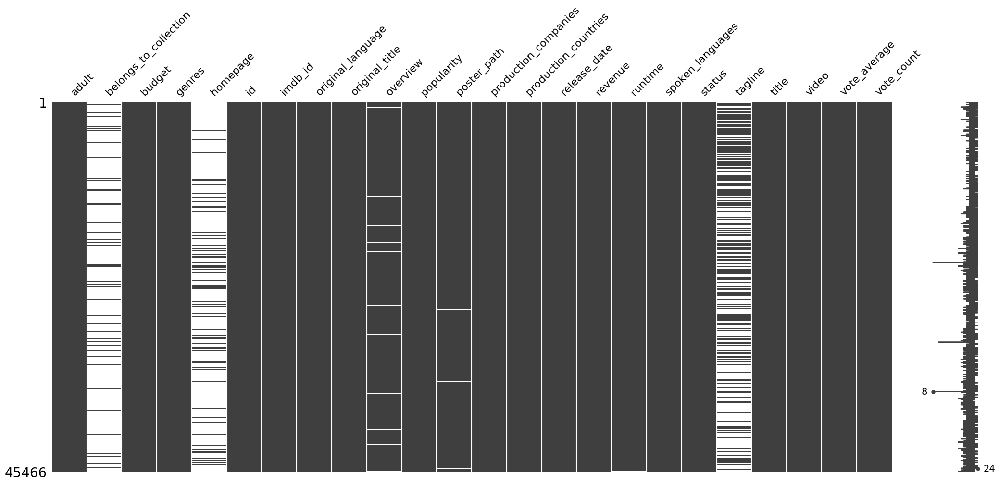

In [4]:
msno.matrix(df)

Debera considerarse que hacer con las columnas como belong_to_collection, homepage y tagline, que son las que tienen mayor cantidad de valores nulos.

#### 1.2 Tratamiento sobre columnas que sean colecciones

Para almacenar estos valores anidados, se procedera a guardarlos en una formato de lista de listas



In [5]:
df_diccts = df[['belongs_to_collection','genres','production_companies','production_countries','spoken_languages']] 

In [6]:
df_diccts.sample(3)

,belongs_to_collection,genres,production_companies,production_countries,spoken_languages
3283,NaN,"[{'id': 10749, 'name': 'Romance'}, {'id': 35, ...","[{'name': 'British Lion Film Corporation', 'id...","[{'iso_3166_1': 'GB', 'name': 'United Kingdom'...","[{'iso_639_1': 'en', 'name': 'English'}]"
39658,NaN,"[{'id': 878, 'name': 'Science Fiction'}, {'id'...",[],"[{'iso_3166_1': 'US', 'name': 'United States o...","[{'iso_639_1': 'en', 'name': 'English'}]"
20762,NaN,"[{'id': 18, 'name': 'Drama'}, {'id': 35, 'name...",[],"[{'iso_3166_1': 'US', 'name': 'United States o...","[{'iso_639_1': 'en', 'name': 'English'}]"


In [7]:
from Funciones import convertir_dicc_to_list #para estructuras como belong_to_collection
from Funciones import convertir_list_to_dicct # para estructuras como genres
from Funciones import convertir_str_list # para estructuras como spoken_lenguage

In [8]:
col1 =df['belongs_to_collection']
col2 =df['genres']
col3 =df['production_companies']
col4 =df['production_countries']
col5 =df['spoken_languages']

col1 = convertir_dicc_to_list(col1)
col2 = convertir_list_to_dicct(col2)
col3 = convertir_list_to_dicct(col3)
col4 = convertir_list_to_dicct(col4)
col5 = convertir_str_list(col5)


In [9]:
#reemplazar los valores de las columnas por estas nuevas listas
df['belongs_to_collection'] = pd.Series(col1)
df['genres'] = pd.Series(col2)
df['production_companies'] = pd.Series(col3)
df['production_countries'] = pd.Series(col4)
df['spoken_languages'] = pd.Series(col5)

In [10]:
df[['belongs_to_collection','genres','production_companies','production_countries','spoken_languages']].sample(5)

,belongs_to_collection,genres,production_companies,production_countries,spoken_languages
38516,NaN,"[[35, Comedy]]",NaN,NaN,NaN
31951,NaN,"[[53, Thriller], [27, Horror], [9648, Mystery]]",NaN,NaN,NaN
7088,NaN,"[[10752, War], [18, Drama]]","[[Zespól Filmowy ""Kadr"", 1829]]","[[PL, Poland]]","[[iso_639_1, de], [name, Deutsch], [iso_639_1,..."
44879,NaN,"[[35, Comedy]]",NaN,NaN,NaN
16303,NaN,"[[18, Drama], [10749, Romance]]",[],[],[]


### 1.3 Requisitos de procesamiento de los datos

#### requisitos:

- 1.3.1 Los valores nulos de los campos revenue, budget deben ser rellenados por el número 0.

- 1.3.2 Los valores nulos del campo release date deben eliminarse.

- 1.3.3 De haber fechas, deberán tener el formato AAAA-mm-dd, además deberán crear la columna release_year donde extraerán el año de la fecha de estreno.

- 1.3.4 Crear la columna con el retorno de inversión, llamada return con los campos revenue y budget, dividiendo estas dos últimas revenue / budget, cuando no hay datos disponibles para calcularlo, deberá tomar el valor 0.

- 1.3.5 Eliminar las columnas que no serán utilizadas, video,imdb_id,adult,original_title,poster_path y homepage.

- 1.3.6 columna release_year con el año

- 1.3.7 convertir tipos de dato


In [11]:
# 1.3.1
df['revenue'].fillna(0,inplace=True)
df['budget'].fillna(0,inplace=True)
#1.3.2
df = df.dropna(axis=0,subset='release_date')
#1.3.3
df['release_date'] = pd.to_datetime(df['release_date'],errors='coerce')
df['release_year'] = df['release_date'].dt.year
#1.3.4
df['budget'] = pd.to_numeric(df['budget'],errors='coerce')
df['return'] = np.where((df['budget'].isna() | df['revenue'].isna() | (df['budget'] == 0)),
                     0, df['revenue'] / df['budget'])
#1.3.5
df = df.drop(columns= ['video','imdb_id','adult','original_title','poster_path','homepage'])
#1.3.6
df['release_year'] = df['release_date'].dt.year
# 1.3.7
df['id'] = pd.to_numeric(df['id'],errors='coerce')
df['popularity'] = pd.to_numeric(df['popularity'],errors='coerce')


# Dataset: Credits

#### 2.1 Lectura del dataset: Credits

In [12]:
df_creditos = pd.read_csv("../credits.csv")

In [13]:
df_creditos.head(3)

,cast,crew,id
0,"[{'cast_id': 14, 'character': 'Woody (voice)',...","[{'credit_id': '52fe4284c3a36847f8024f49', 'de...",862
1,"[{'cast_id': 1, 'character': 'Alan Parrish', '...","[{'credit_id': '52fe44bfc3a36847f80a7cd1', 'de...",8844
2,"[{'cast_id': 2, 'character': 'Max Goldman', 'c...","[{'credit_id': '52fe466a9251416c75077a89', 'de...",15602


#### 2.2 creacion de dataframes individuales para cast y crew

#### 2.2.1 df cast

In [14]:
linea_cast = df_creditos['cast']
linea_id = df_creditos['id']

## Para almacenar la informacion de cast, se procedera a crear un dataframe, donde cada "clave" sera una columna
## y cada "valor" sera una instancia, iterando sobre cada instancia de la columna cast,
## guardando el id, para que el nuevo dataframe tambien tenga el valor del id correspondiente de credits.
## Ademas de los valores del diccionario.
datos_cast = {}
datos_cast["id_credit"] = []
datos_cast["cast_id"] = []
datos_cast["character"] = []
datos_cast["credit_id"] = []
datos_cast["gender"] = []
datos_cast["id"] = []
datos_cast["name"] = []
datos_cast["order"] = []
datos_cast["profile_path"] = []
try:
    for idx, lis in enumerate(linea_cast):
        linea = ast.literal_eval(lis)
        id_actual = linea_id.iloc[idx]
        for dic in linea:
            datos_cast['id_credit'].append(id_actual)
            for clave,valor in dic.items():
                datos_cast[clave].append(valor)
except:
    pass

datos_cast = pd.DataFrame(datos_cast)

print(datos_cast.shape)
datos_cast.head()

(562474, 9)


,id_credit,cast_id,character,credit_id,gender,id,name,order,profile_path
0,862,14,Woody (voice),52fe4284c3a36847f8024f95,2,31,Tom Hanks,0,/pQFoyx7rp09CJTAb932F2g8Nlho.jpg
1,862,15,Buzz Lightyear (voice),52fe4284c3a36847f8024f99,2,12898,Tim Allen,1,/uX2xVf6pMmPepxnvFWyBtjexzgY.jpg
2,862,16,Mr. Potato Head (voice),52fe4284c3a36847f8024f9d,2,7167,Don Rickles,2,/h5BcaDMPRVLHLDzbQavec4xfSdt.jpg
3,862,17,Slinky Dog (voice),52fe4284c3a36847f8024fa1,2,12899,Jim Varney,3,/eIo2jVVXYgjDtaHoF19Ll9vtW7h.jpg
4,862,18,Rex (voice),52fe4284c3a36847f8024fa5,2,12900,Wallace Shawn,4,/oGE6JqPP2xH4tNORKNqxbNPYi7u.jpg


#### 2.2.2 df crew

In [15]:
linea_crew = df_creditos['crew']
linea_id = df_creditos['id']

datos_crew = {}
datos_crew["id_credit"] = []
datos_crew["credit_id"] = []
datos_crew["department"] = []
datos_crew["gender"] = []
datos_crew["id"] = []
datos_crew["job"] = []
datos_crew["name"] = []
datos_crew["profile_path"] = []
try:
    for idx, lis in enumerate(linea_crew):
        linea = ast.literal_eval(lis)
        id_actual = linea_id.iloc[idx]
        for dic in linea:
            datos_crew["id_credit"].append(id_actual)  # Agrega el id original repetido
            for clave, valor in dic.items():
                datos_crew[clave].append(valor)
except Exception as e:
    print(f"Ocurrió un error: {e}")

# Convertir a DataFrame para verificar los resultados
datos_crew = pd.DataFrame(datos_crew)
datos_crew.head()

,id_credit,credit_id,department,gender,id,job,name,profile_path
0,862,52fe4284c3a36847f8024f49,Directing,2,7879,Director,John Lasseter,/7EdqiNbr4FRjIhKHyPPdFfEEEFG.jpg
1,862,52fe4284c3a36847f8024f4f,Writing,2,12891,Screenplay,Joss Whedon,/dTiVsuaTVTeGmvkhcyJvKp2A5kr.jpg
2,862,52fe4284c3a36847f8024f55,Writing,2,7,Screenplay,Andrew Stanton,/pvQWsu0qc8JFQhMVJkTHuexUAa1.jpg
3,862,52fe4284c3a36847f8024f5b,Writing,2,12892,Screenplay,Joel Cohen,/dAubAiZcvKFbboWlj7oXOkZnTSu.jpg
4,862,52fe4284c3a36847f8024f61,Writing,0,12893,Screenplay,Alec Sokolow,/v79vlRYi94BZUQnkkyznbGUZLjT.jpg


#### 3.0 Datasets: movies, cast y crew

In [16]:
print("dataset movies",df.shape)
print("dataset crew ",datos_crew.shape)
print("dataset cast",datos_cast.shape)

dataset movies (45379, 20)
dataset crew  (464314, 8)
dataset cast (562474, 9)


#### 3.1 Opcion a: cargar los datos como csv

In [17]:
#datos_cast.to_csv('df_cast.csv',index=False)
#datos_crew.to_csv('df_crew.csv',index=False)
#df.to_csv('movies.csv',index=False)

#### 3.1 Opcion b: transformar los tipos de datos anidados y almacenarlos en formato .parquet.

Debido a que parquet no soporta estrucutras anidadas de manera tan directa, se debera convertir los tipos de lista de listas a string de json sobre las columnas que tengan este tipo de estructura. Luego para desanidarlas se usara la misma funcion para convertirlos nuevamente a objetos de python

In [18]:
df['belongs_to_collection'] = df['belongs_to_collection'].apply(json.dumps)
df['production_companies'] = df['production_companies'].apply(json.dumps)
df['production_countries'] = df['production_countries'].apply(json.dumps)
df['spoken_languages'] = df['spoken_languages'].apply(json.dumps)

#### 3.2 Recorte de los datasets: Optimizacion de recursos
de la data "movies" se eliminaran las columnas de belongs_to_collection, production_companies, production_countries, spoken_languages y tagline	

de la data de credits:

crew: se eliminaran las columnas: credit_id, profile_path

cast: se eliminaran las columnas: credit_id, profile_path

In [19]:
df = df.drop(columns=['belongs_to_collection', 'production_companies', 'production_countries', 'spoken_languages', 'tagline'])
datos_crew = datos_crew.drop(columns=['credit_id'])
datos_cast = datos_cast.drop(columns=['credit_id'])
datos_cast = datos_cast.drop(columns=['profile_path'])
datos_crew = datos_crew.drop(columns=['profile_path'])

#### 3.3 Tokenizacion, lematizacion y eliminacion de nulos para "overview"

Para relacionar las peliculas vamos a necesitar una columna con las palabras claves de cada pelicula, en este caso la llamaremos overview_tokenizado.
Donde la funcion procesamiento tokeniza el texto, elimina las stop words y lematiza las palabras.
Ademas para ello necesitaremos no tener valores nulos en los datos.
 

In [20]:
df.dropna(subset=['overview'],axis=0,inplace=True)
from Funciones import preprocesamiento # importamos preprocesamiento para lematizar la data
df['overview_tokenizado'] = df['overview'].apply(preprocesamiento)

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Pablo\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\User

### 3.4 creacion de la columna generos

In [21]:
from Funciones import juntar_listas
df['generos'] = df['genres'].apply(juntar_listas)
df['genres'] = df['genres'].apply(json.dumps)

In [22]:
df.to_parquet('data/df_movies_parquet.parquet',engine='pyarrow')
datos_cast.to_parquet('data/df_cast_parquet.parquet',engine='pyarrow')
datos_crew.to_parquet('data/df_crew_parquet.parquet',engine='pyarrow')

## Finalizacion del proceso de Extraccion, Transformacion y Carga(Load) de los datos.

In [155]:
#ejemplo de lectura y des serializacion de 1 columna
df_leido = pd.read_parquet('data/df_movies_parquet.parquet', engine='pyarrow')
df_leido['genres'] = df_leido['genres'].apply(json.loads)
print(df_leido['genres'][0])
print(df_leido['genres'][0][1])
print(df_leido['genres'][0][1][1])

[[16, 'Animation'], [35, 'Comedy'], [10751, 'Family']]
[35, 'Comedy']
Comedy
